In [2]:
import besseTBC
import numpy as np
import matplotlib.pyplot as plt
import kdv
import generalFunctions as gF
import pickle

%matplotlib inline

# First test : $u_0(x) = e^{-x^2}$

In [3]:
computeExactSolution = False

L = 6.
xmin = -L
xmax = L
N = 500.
U2 = 1.
t0 = 0.
tmax = 4.
dt = 5*4/2560.

dx = (xmax-xmin)/N
x = kdv.discretizeSpace(xmin,xmax,dx)
x = np.linspace(xmin,xmax,N)
cLs = np.arange(1.0,1.23,0.01)
cRs = np.array([1.])

u = besseTBC.initGauss(x)

tallaux = np.arange(t0,tmax+dt,dt)

uallexact = np.zeros((u.size,tallaux.size))
uallexact[:,0] = np.copy(u)

if computeExactSolution :
    print("*** Computing initial solution")
    for i in range(1,tallaux.size) :
        if i%10 == 0:
            print(r"t = %.6f"%tallaux[i])
        uallexact[:,i] = besseTBC.exactSolution(x,tallaux[i],besseTBC.initGauss)

    #Save initial solution
    fn = "initGauss"
    with open(fn,'w') as f:
        pickle.dump(uallexact,f)
    uallexact2 = np.copy(uallexact)
else :
    #Load initial solution
    fn = "initGauss"
    with open(fn,'r') as f:
        uallexact = pickle.load(f)
#print(np.linalg.norm(uallexact-uallexact2))
    
filename = 'optimO0exp1000.json'
testsLight = besseTBC.loadTests(filename)

uall,uallexact,tall,tests,testsLight,errors,testTmmax,testTmmin,testL2max,testL2min = besseTBC.optimizeParamO0(x,u,uallexact,t0,tmax,
                                                    U2,cLs,cRs, N, dt, testsLight, verbose = True,LeD = False)

besseTBC.saveTests(testsLight,filename)

(array([ 1.  ,  1.01,  1.02,  1.03,  1.04,  1.05,  1.06,  1.07,  1.08,
        1.09,  1.1 ,  1.11,  1.12,  1.13,  1.14,  1.15,  1.16,  1.17,
        1.18,  1.19,  1.2 ,  1.21,  1.22]), array([ 1.]))
(136, 3)
('ErrTm Max = ', 0.28652519445539437, '(cL,cR) = ', '(-0.10000000000000001, 1.0)')
('ErrTm Min = ', 0.0736286799308596, '(cL,cR) = ', '(1.1200000000000003, 1.0)')
('ErrL2 Max = ', 0.3966315597705641, '(cL,cR) = ', '(-10.0, -1.0)')
('ErrL2 Min = ', 0.0913783123001285, '(cL,cR) = ', '(1.1600000000000004, 1.0)')


In [4]:
besseTBC.showRanking(testsLight,10,"Tm")

Best results
('(1.160,1.000)', '0.0676650062698', '0.0913783123001')
('(1.160,1.000)', '0.0676650062698', '0.0913783123001')
('(1.170,1.000)', '0.0680524382763', '0.0916553301635')
('(1.150,1.000)', '0.0682588530053', '0.0911635496006')
('(1.180,1.000)', '0.0684270710696', '0.0919922763816')
('(1.180,1.000)', '0.0684270710696', '0.0919922763816')
('(1.190,1.000)', '0.0687892320306', '0.0923867720002')
('(1.200,1.000)', '0.0691392411819', '0.0928364018524')
('(1.200,1.000)', '0.0691392411819', '0.0928364018524')
('(1.200,1.000)', '0.0691392411877', '0.0928364018337')


In [5]:
besseTBC.showRanking(testsLight,10,"L2")

Best results
('(1.120,1.000)', '0.0736286799309', '0.0909149371029')
('(1.120,1.000)', '0.0736286799309', '0.0909149371029')
('(1.130,1.000)', '0.0718269254108', '0.0909297389953')
('(1.110,1.000)', '0.0754416225049', '0.090970850248')
('(1.140,1.000)', '0.0700368229724', '0.0910133006419')
('(1.140,1.000)', '0.0700368229724', '0.0910133006419')
('(1.100,1.000)', '0.077265302768', '0.0910993014758')
('(1.100,1.000)', '0.077265302768', '0.0910993014758')
('(1.150,1.000)', '0.0682588530053', '0.0911635496006')
('(1.090,1.000)', '0.0790992817703', '0.0913019676623')



*** Computing solution ...
*** End of computation ***


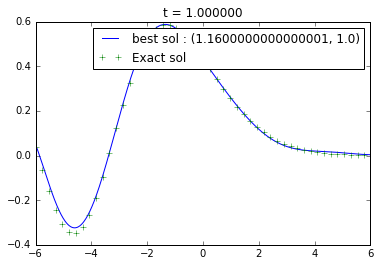

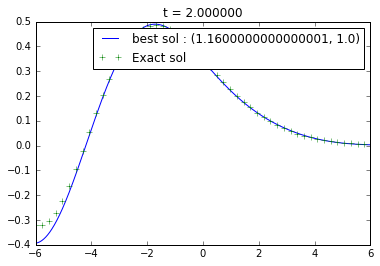

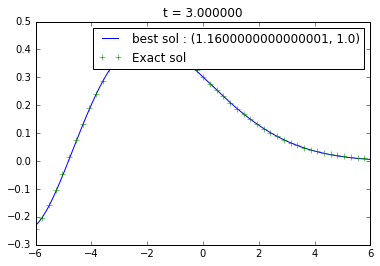

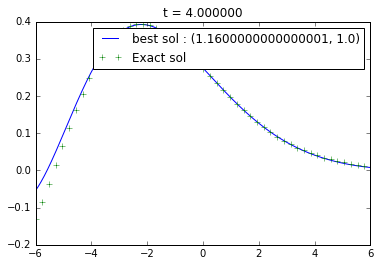

In [25]:
tsnaps = np.array([1.,2.,3.,4.])
besseTBC.plotBestSolution(x,u,uallexact,U2,t0,tmax,dt,tall,tsnaps,testsLight,criteria="Tm")

(None, None, -10.0, 10.0)
(-10.0, 10.0, 100000000, -100000000)
(-10.0, 10.0, -10.0, 10.0)
(-10.0, 10.0, 0.067665006269800002, 0.42176376133999999)
(0.8, 2.0, -10.0, 10.0)
(0.8, 2.0, 100000000, -100000000)
(0.8, 2.0, -10.0, 10.0)
(0.8, 2.0, 0.067665006269800002, 0.13483383171300001)


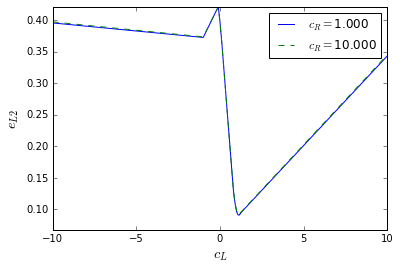

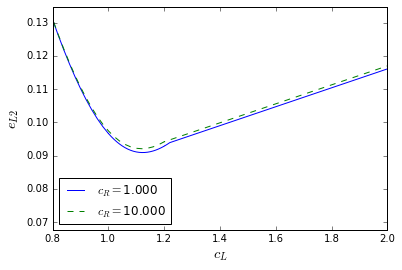

In [13]:
reload(besseTBC)

besseTBC.plotCoefError(testsLight,np.array([1.,10.]),fixedCoef="right",plotErrors="L2",
                       savePath="figures/errorOptimOnlyL2")
besseTBC.plotCoefError(testsLight,np.array([1.,10.]),fixedCoef="right",minCoef=.8,maxCoef=2.,plotErrors="L2",
                      savePath="figures/errorOptimOnlyL2Detail")


*** Computing solution ...
*** End of computation ***
*** Plotting animation ...



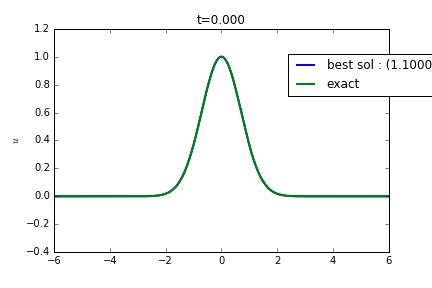
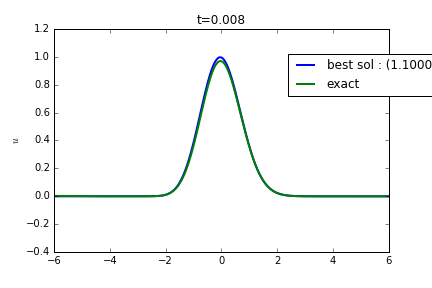
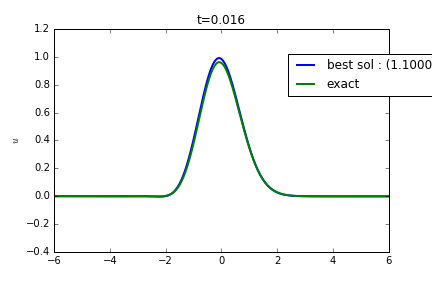
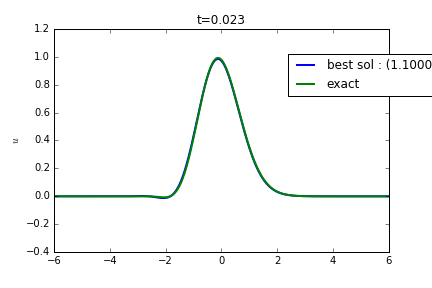
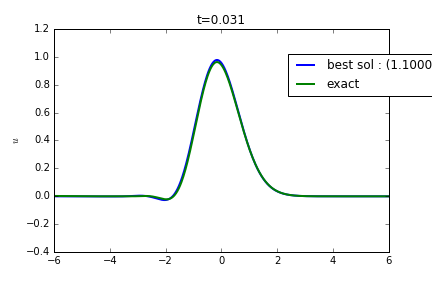
...
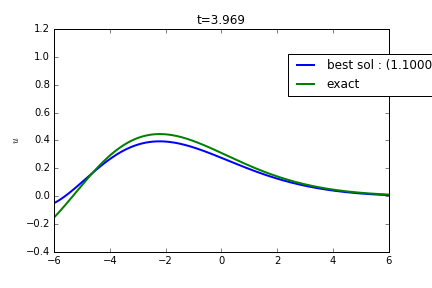
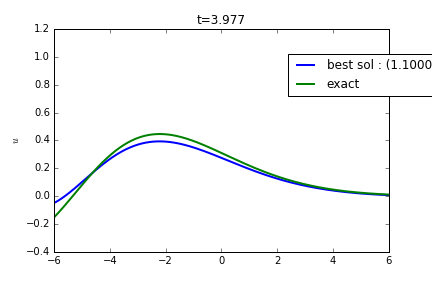
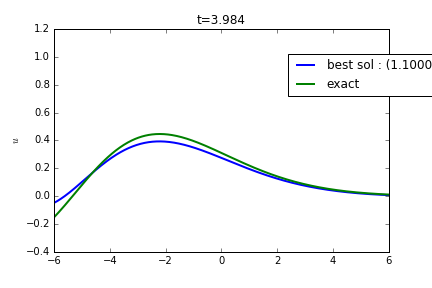
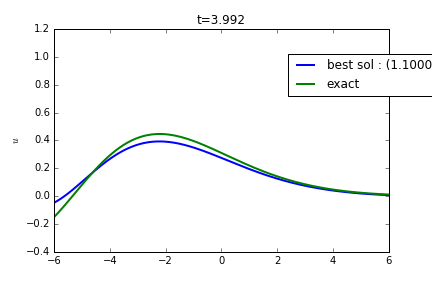
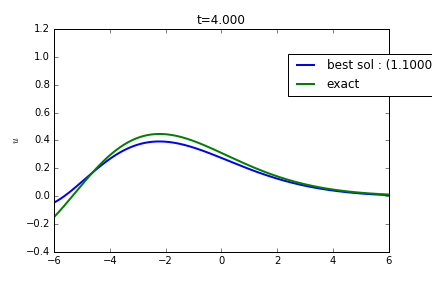

In [20]:
besseTBC.animateBestSolution(x,u,uallexact,U2,t0,tmax,dt,testsLight,criteria="L2")

# Second test : Square wave

In [68]:
## L = 6.
xmin = -L
xmax = L
N = 500.
U2 = 1.
t0 = 0.
tmax = 4.
dt = 5*4/2560./2.

dx = (xmax-xmin)/N
x = kdv.discretizeSpace(xmin,xmax,dx)
x = np.linspace(xmin,xmax,N)
cLs = np.arange(0.8,1.25,.5)
cRs = np.array([0.])

u = f(x)

tallaux = np.arange(t0,tmax+dt,dt)

uallexact = np.zeros((u.size,tallaux.size))
uallexact[:,0] = np.copy(u)
for i in range(1,tallaux.size) :
    uallexact[:,i] = besseTBC.exactSolution(x,tallaux[i],f)

filename = 'optimO0square.json'
testsLight = besseTBC.loadTests(filename)

uall,uallexact,tall,tests,testsLight,errors,testTmmax,testTmmin,testL2max,testL2min = besseTBC.optimizeParamO0(x,u,uallexact,t0,tmax,
                                                    U2,cLs,cRs, N, dt, testsLight, verbose = True,LeD = False)

besseTBC.saveTests(testsLight,filename)

(array([ 0.8]), array([ 0.]))

*** Computing solution ...


KeyboardInterrupt: 

In [63]:
besseTBC.showRanking(testsLight,9,"L2")

Best results
('(1.000,0.000)', '0.216866610263', '0.292142151862')
('(1.000,1.000)', '0.218925233843', '0.292199979498')
('(1.000,10.000)', '0.218722869801', '0.292657095121')
('(10.000,0.000)', '0.329964502085', '0.48840483762')
('(10.000,1.000)', '0.330846341035', '0.490902265127')
('(10.000,10.000)', '0.335283184923', '0.492947470209')
('(0.000,0.000)', '0.336059633991', '0.522545765359')
('(0.000,10.000)', '0.327968861596', '0.523634216544')
('(0.000,1.000)', '0.3329606629', '0.524273065621')



*** Computing solution ...
*** End of computation ***


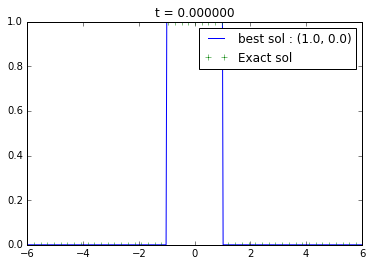

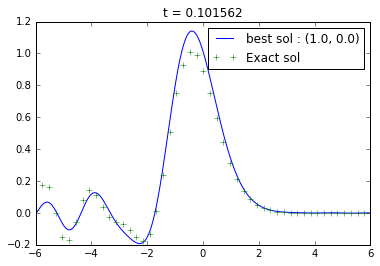

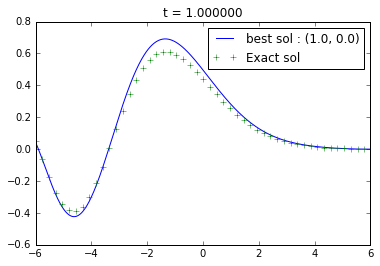

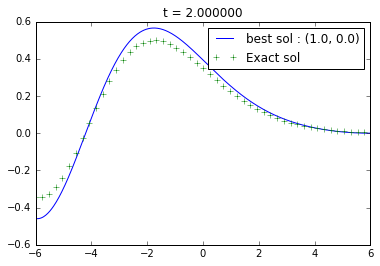

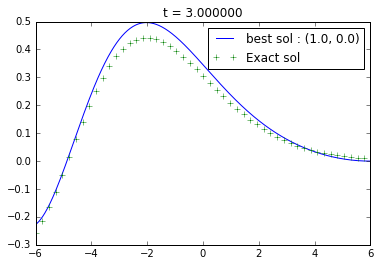

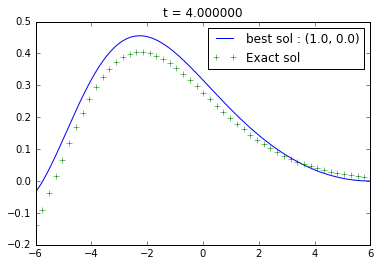

In [64]:
tsnaps = np.array([0.,0.1,1.,2.,3.,4.])
besseTBC.plotBestSolution(x,u,uallexact,U2,t0,tmax,dt,tall,tsnaps,testsLight,criteria="L2")


*** Computing solution ...
*** End of computation ***
*** Plotting animation ...



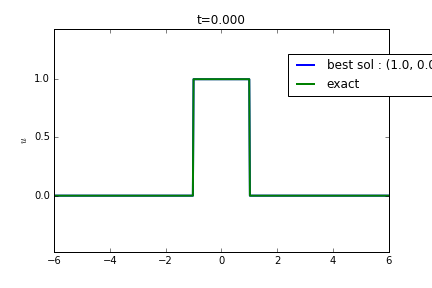
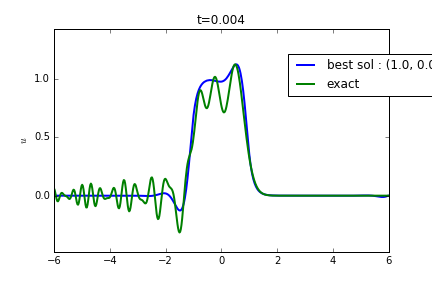
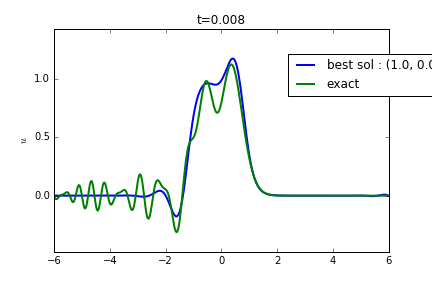
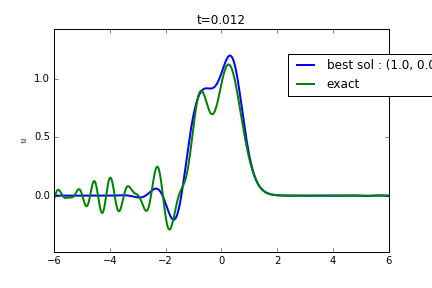
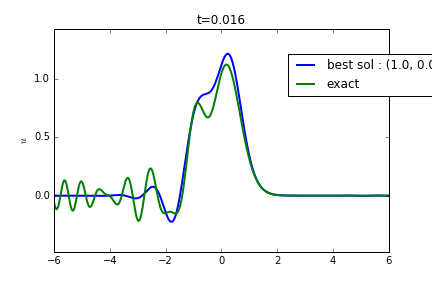
...
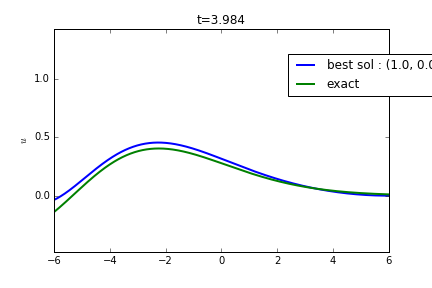
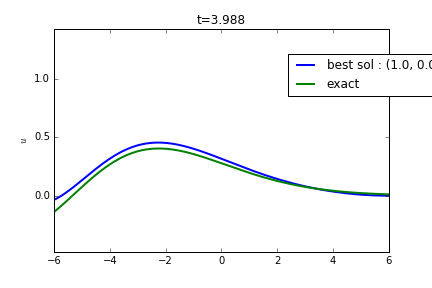
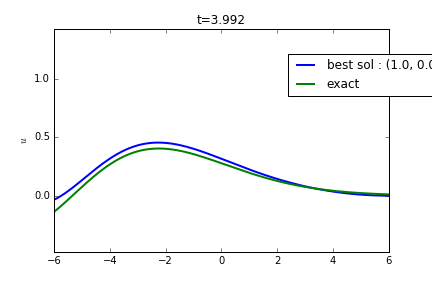
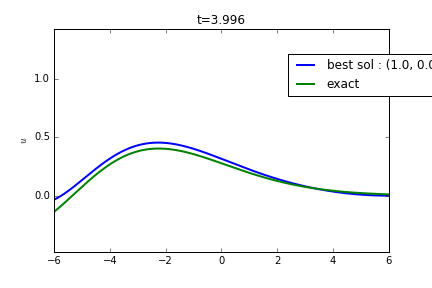
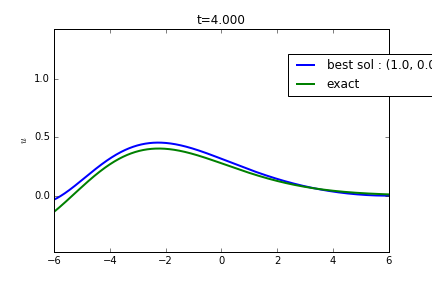

In [65]:
besseTBC.animateBestSolution(x,u,uallexact,U2,t0,tmax,dt,testsLight,criteria="L2")

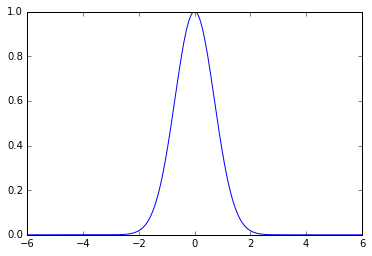

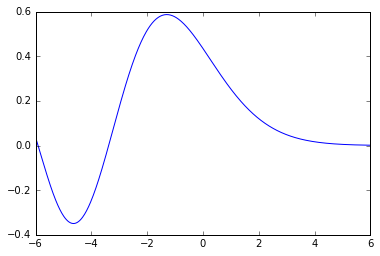

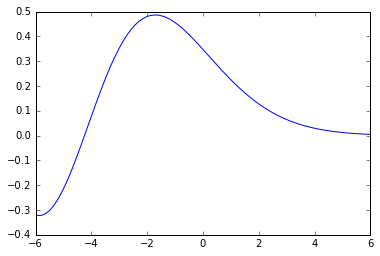

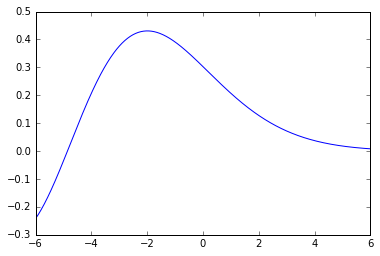

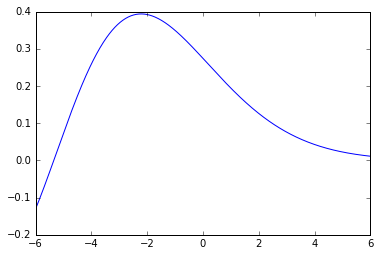

In [29]:
def f(x) :
    return np.where(x<-1,0.,np.where(x>1,0.,1.))

u = besseTBC.initGauss(x)
plt.plot(x,u)
for t in [1,2,3,4]:
    ue = besseTBC.exactSolution(x,t,besseTBC.initGauss)
    plt.figure()
    plt.plot(x,ue)

In [3]:
coefTBC = np.zeros((1,2))
coefTBC[0,0]  = 1.
coefTBC[0,1] = 1.
uall,tall = besseTBC.runDispKdV(x,u,t0,tmax,U2, coefTBC ,periodic=0, vardt = False, dt = dt, verbose = False,
                                              order = 0)


*** Computing solution ...
*** End of computation ***


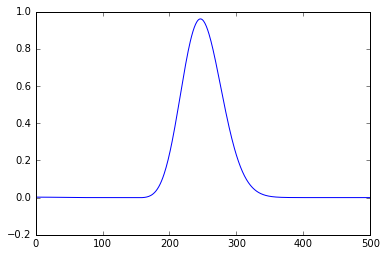

In [4]:
plt.plot(uallexact[:,2])

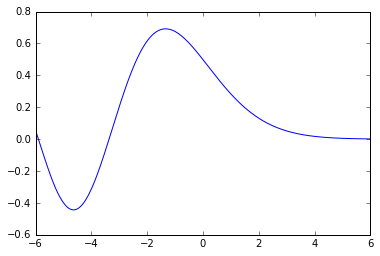

In [30]:
def exactSolution(x,t,initCond) :
    dx = x[1] - x[0]
    left = np.arange(x[0]-1000.,x[0],dx)
    sizeL = np.size(left)
    right = np.arange(x[-1] + dx,x[-1] + 1000., dx)
    sizeR = np.size(right)
    x2 = np.concatenate((left,x,right))

    uf = besseTBC.fundamentalSolution(x2,t)
    u0 = initCond(x2)
    
    b = np.convolve(uf/np.sum(uf),u0,'same')
    c = b[sizeL:sizeL+x.size]
    return c



u = exactSolution(x,1.,f)
plt.plot(x,u)

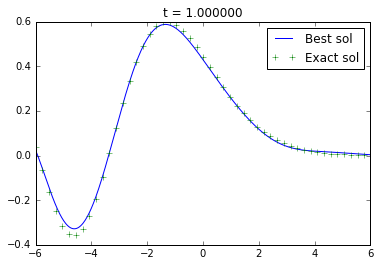

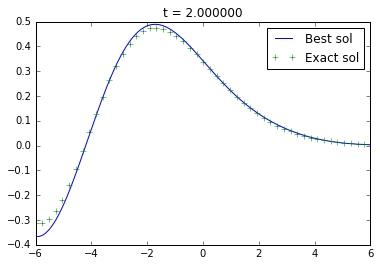

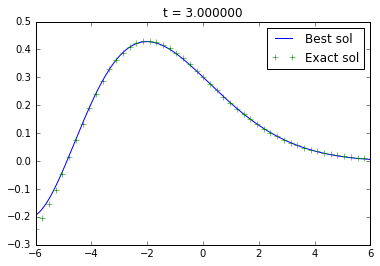

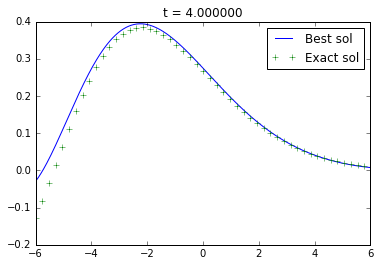

In [13]:
for i in range(1,tallaux.size) :
    uallexact[:,i] = besseTBC.exactSolution(x,tallaux[i],besseTBC.initSquare)

for t in [1.,2.,3.,4.] :
    plt.figure()
    it = np.argmin(np.absolute(tall-t))
    plt.plot(x,uall[:,it],label='Best sol')
    plt.plot(x,uallexact[:,it],marker='+',markevery=10,linestyle='None', label='Exact sol')
    plt.title(r't = %f'%tall[it])
    plt.legend()
    
    

(None, None, -10.0, 10.0)
(-10.0, 10.0, 100000000, -100000000)
(-10.0, 10.0, -10.0, 10.0)
(-10.0, 10.0, 0.067665006269800002, 0.42176376133999999)
(0.8, 2.0, -10.0, 10.0)
(0.8, 2.0, 100000000, -100000000)
(0.8, 2.0, -10.0, 10.0)
(0.8, 2.0, 0.067665006269800002, 0.13483383171300001)


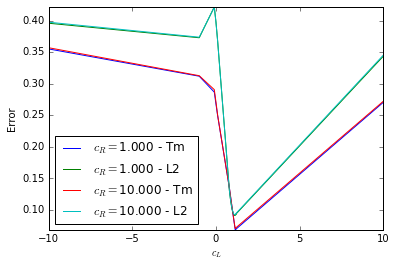

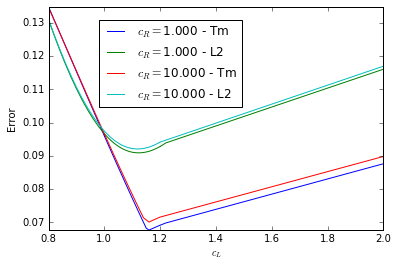

In [13]:
def plotCoefError(testsLight,fixedValues,fixedCoef = "right",minCoef=None,maxCoef=None,
                  savePath=None,ext="png",legloc = 0):

    plt.figure()
    
    if fixedCoef == "right" :
        fixedIndex = 1
        leg = r"$c_R = $"
        title = "$c_R$ fixed"
        xlbl = "$c_L$"
    elif fixedCoef == "left" :
        fixedIndex = 0
        leg = r"$c_L = $"
        title = "$c_L$ fixed"
        xlbl = "$c_R$"
        
    ## string -> (cL,cR)
    testsList = np.array([(key,float(testsLight[key][0]), float(testsLight[key][1]))for key in testsLight.keys()])
    testsCoefsList = np.zeros((testsList.shape[0],4))
    
    for i in range(testsCoefsList.shape[0]) :
        tup = eval(testsList[i,0])
        testsCoefsList[i,0] = tup[0]
        testsCoefsList[i,1] = tup[1]
    testsCoefsList[:,2:4] = testsList[:,1:3] ## cL,cR,Tm,L2


    errormin = 100000000
    errormax = -100000000
    for fixed in fixedValues :
        filtredList = np.zeros((1,3))
        line = np.zeros((1,3))
        for i in range(testsCoefsList.shape[0]):
            if np.absolute(testsCoefsList[i,fixedIndex] - fixed) < 1e-6 :
                line[0,0] = testsCoefsList[i,1-fixedIndex] ## cL,Tm,L2
                line[0,1:3] = testsCoefsList[i,2:4]
                filtredList = np.concatenate((filtredList,line))
        filtredList = np.delete(filtredList,0,0)
        filtredList = filtredList[np.argsort(filtredList[:,0])]
        plt.plot(filtredList[:,0],filtredList[:,1],label=leg + r"%.3f"%fixed + " - Tm")
        plt.plot(filtredList[:,0],filtredList[:,2],label=leg + r"%.3f"%fixed + " - L2")
    
        print(minCoef,maxCoef,filtredList[0,0],filtredList[-1,0])
        if minCoef == None:
            minCoef = 100000000
            if (filtredList[0,0] < minCoef):
                minCoef = filtredList[0,0]
        if maxCoef == None :
            maxCoef = -100000000
            if (filtredList[-1,0] > maxCoef):
                maxCoef = filtredList[-1,0]

        print(minCoef,maxCoef,errormin,errormax)
        idxmin = np.argmin(np.absolute(filtredList[:,0]-minCoef))
        idxmax = np.argmin(np.absolute(filtredList[:,0]-maxCoef))
        if np.amin([filtredList[idxmin:idxmax+1,1:]]) < errormin:
            errormin = np.amin([filtredList[idxmin:idxmax+1,1:]])
        if np.amax([filtredList[idxmin:idxmax+1,1:]]) > errormax:
            errormax = np.amax([filtredList[idxmin:idxmax+1,1:]])

    plt.xlim((minCoef,maxCoef))
    plt.ylim((errormin,errormax))
    plt.xlabel(xlbl)
    plt.ylabel("Error")
    #plt.title(title)
    plt.legend(loc=legloc)
    
    if savePath != None:
        plt.savefig(savePath+"."+ext)
        
plotCoefError(testsLight,np.array([1.,10.]),fixedCoef="right",savePath="figures/TBCbesse/errorOptim")        
plotCoefError(testsLight,np.array([1.,10.]),fixedCoef="right",minCoef=.8,maxCoef=2.,
              savePath="figures/TBCbesse/errorOptimDetail",legloc=(0.15,0.55)) 

array([[ 0.,  0.,  0.],
       [ 1.,  1.,  1.]])